In [1]:
import pandas as pd
import numpy as np

data = pd.read_csv('../data/backtest_data_after_regime_prediction.csv')
data['Date'] = pd.to_datetime(data['Date'])
data.set_index('Date', inplace=True)

## Add bollinger bands

In [2]:
# create a moving average
data['ema_20'] = data['Close'].ewm(span=20, adjust=False).mean()

# add a 10-day EMA
data['ema_10'] = data['Close'].ewm(span=10, adjust=False).mean()


In [3]:
# add bollinger bands 1SD from ema_20

# Calculate the standard deviation over the same span
data['stddev_20'] = data['Close'].ewm(span=20, adjust=False).std()

# Calculate the upper Bollinger Band 1SD
data['upper_band_1sd'] = data['ema_20'] + (data['stddev_20'] * 1)

# Calculate the lower Bollinger Band 1SD
data['lower_band_1sd'] = data['ema_20'] - (data['stddev_20'] * 1)

# Calculate the upper Bollinger Band 1.5SD
data['upper_band_1.5sd'] = data['ema_20'] + (data['stddev_20'] * 1.5)

# Calculate the lower Bollinger Band 1.5SD
data['lower_band_1.5sd'] = data['ema_20'] - (data['stddev_20'] * 1.5)

# Calculate the upper Bollinger Band 2SD
data['upper_band_2sd'] = data['ema_20'] + (data['stddev_20'] * 2)

# Calculate the lower Bollinger Band 2SD
data['lower_band_2sd'] = data['ema_20'] - (data['stddev_20'] * 2)

## Add fibonacci levels

In [4]:
# Create new columns for Fibonacci levels
data['fib_level_0.236'] = np.nan
data['fib_level_0.382'] = np.nan
data['fib_level_0.5'] = np.nan  # Added 0.5 level
data['fib_level_0.618'] = np.nan

# Calculate Fibonacci levels for each day
for i in range(251, len(data)):
    window = data.iloc[i-251:i+1]
    low = window['Low'].min()
    high = window['High'].max()
    diff = high - low
    data.loc[data.index[i], 'fib_level_0.236'] = high - 0.236 * diff
    data.loc[data.index[i], 'fib_level_0.382'] = high - 0.382 * diff
    data.loc[data.index[i], 'fib_level_0.5'] = high - 0.5 * diff  # Calculate 0.5 level
    data.loc[data.index[i], 'fib_level_0.618'] = high - 0.618 * diff

## Add MACD

In [5]:
# Define the short and long lookback periods
short_period = 12 #12 day ema
long_period = 26 #26 day ema

# Calculate the short and long period exponential moving averages
data['short_ema'] = data['Close'].ewm(span=short_period, adjust=False).mean()
data['long_ema'] = data['Close'].ewm(span=long_period, adjust=False).mean()

# Calculate the MACD line
data['MACD_line'] = data['short_ema'] - data['long_ema']

# Calculate the signal line
signal_period = 9
data['signal_line'] = data['MACD_line'].ewm(span=signal_period, adjust=False).mean()

# Calculate the MACD histogram
data['MACD_histogram'] = data['MACD_line'] - data['signal_line']

## Add RSI

In [6]:
# Define the lookback period
lookback_period = 14

# Calculate the difference in price
delta = data['Close'].diff()

# Separate positive and negative differences
up, down = delta.copy(), delta.copy()
up[up < 0] = 0
down[down > 0] = 0

# Calculate the average gain and average loss
avg_gain = up.ewm(com=lookback_period-1, min_periods=lookback_period).mean()
avg_loss = abs(down.ewm(com=lookback_period-1, min_periods=lookback_period).mean())

# Calculate RS
RS = avg_gain / avg_loss

# Calculate the RSI
data['RSI'] = 100 - (100 / (1 + RS))

In [44]:
data.tail()

,regime,Volume,Open,High,Low,Close,ema_20,ema_10,stddev_20,upper_band_1sd,...,cross_fib_level_0.236,cross_fib_level_0.382,cross_fib_level_0.5,cross_fib_level_0.618,up_cross,down_cross,up_cross_60,down_cross_30,up_cross_70,down_cross_40
Date,,,,,,,,,,,,,,,,,,,,,
2024-03-01,blue,4748110000,5098.51,5140.33,5094.16,5137.08,5020.372353,5067.778869,99.135149,5119.507501,...,False,False,False,False,False,False,False,False,True,False
2024-03-04,blue,4758440000,5130.99,5149.67,5127.18,5130.95,5030.903557,5079.264529,100.004308,5130.907865,...,False,False,False,False,False,False,False,False,False,False
2024-03-05,blue,4418410000,5110.52,5114.54,5056.82,5078.65,5035.450837,5079.152796,96.203826,5131.654663,...,False,False,False,False,False,True,False,False,False,False
2024-03-06,blue,4559050000,5108.03,5127.97,5092.22,5104.76,5042.051710,5083.808652,93.858649,5135.910359,...,False,False,False,False,False,False,False,False,False,False
2024-03-07,blue,4137980000,5132.38,5165.62,5128.21,5157.36,5053.033452,5097.181624,95.793725,5148.827177,...,False,False,False,False,False,False,False,False,False,False


## Export file

In [8]:
data.to_csv('../data/backtest_data_with_technical_indicators.csv')

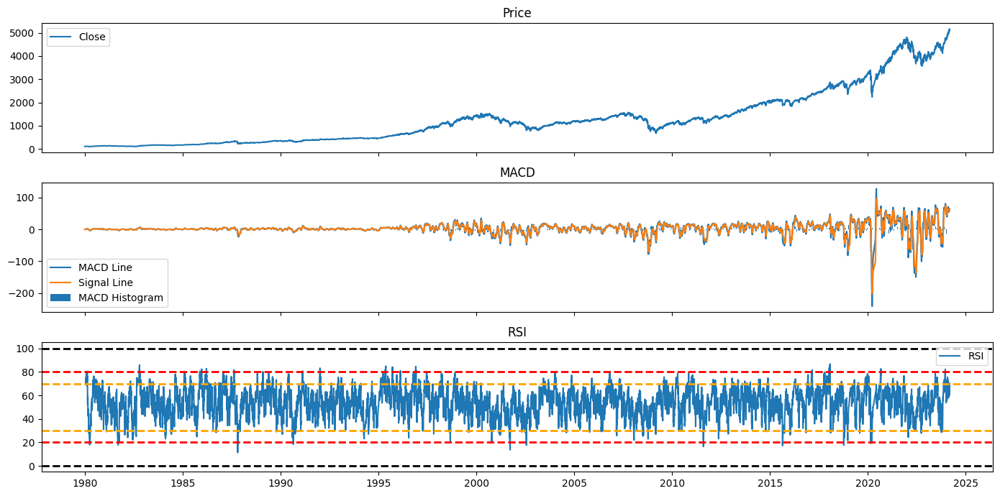

In [9]:
import matplotlib.pyplot as plt

# Create subplots
fig, (ax1, ax2, ax3) = plt.subplots(3, sharex=True, figsize=(14, 7))

# Plot price
ax1.plot(data.index, data['Close'], label='Close')
ax1.set_title('Price')
ax1.legend()

# Plot MACD
ax2.plot(data.index, data['MACD_line'], label='MACD Line')
ax2.plot(data.index, data['signal_line'], label='Signal Line')
ax2.bar(data.index, data['MACD_histogram'], label='MACD Histogram')
ax2.set_title('MACD')
ax2.legend()

# Plot RSI
ax3.plot(data.index, data['RSI'], label='RSI')
ax3.axhline(0, color='black', linewidth=2, linestyle='--')
ax3.axhline(20, color='red', linewidth=2, linestyle='--')
ax3.axhline(30, color='orange', linewidth=2, linestyle='--')
ax3.axhline(70, color='orange', linewidth=2, linestyle='--')
ax3.axhline(80, color='red', linewidth=2, linestyle='--')
ax3.axhline(100, color='black', linewidth=2, linestyle='--')
ax3.set_title('RSI')
ax3.legend()

# Show the plot
plt.tight_layout()
plt.show()

## Price trends for Bollinger Band Indicator

/var/folders/_b/pxw2mfds5xdfm3fbn8tyr7mr0000gn/T/ipykernel_39503/281235646.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  next_30_days['returns'] = next_30_days['Close'].pct_change() + 1
/var/folders/_b/pxw2mfds5xdfm3fbn8tyr7mr0000gn/T/ipykernel_39503/281235646.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  next_30_days['returns'].iloc[0] = 1
/var/folders/_b/pxw2mfds5xdfm3fbn8tyr7mr0000gn/T/ipykernel_39503/281235646.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer

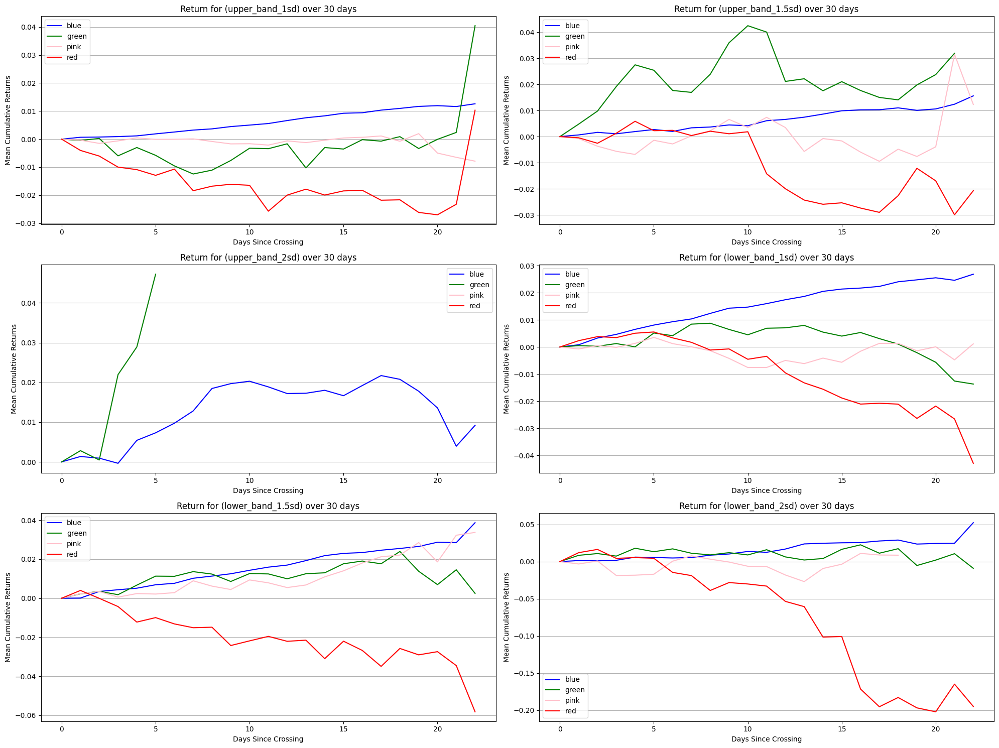

In [10]:
import matplotlib.pyplot as plt

regimes = ['blue', 'green', 'pink', 'red']
bands = ['upper_band_1sd', 'upper_band_1.5sd', 'upper_band_2sd', 'lower_band_1sd', 'lower_band_1.5sd', 'lower_band_2sd']
rows = len(bands)//2+len(bands)%2
mean_returns = {band: {} for band in bands}

for band in bands:
    if 'upper' in band:
        data[f'cross_{band}'] = (data['Close'] > data[band]) & (data['Close'].shift(1) < data[band].shift(1))
    else:
        data[f'cross_{band}'] = (data['Close'] < data[band]) & (data['Close'].shift(1) > data[band].shift(1))
    crossings = data[data[f'cross_{band}']]

    for regime in regimes:
        returns = []

        for date in crossings.index:
            next_30_days = data.loc[date:date + pd.Timedelta(days=30)]
            
            next_30_days['returns'] = next_30_days['Close'].pct_change() + 1
            next_30_days['returns'].iloc[0] = 1
            next_30_days['cumulative_returns'] = next_30_days['returns'].cumprod() - 1

            current_regime = next_30_days['regime'].iloc[0]
            
            if current_regime == regime:
                daily_returns = []
                for next_date, row in next_30_days.iterrows():
                    if row['regime'] != regime:
                        break
                    daily_returns.append(row['cumulative_returns'])
                returns.append(daily_returns)

        if returns:
            max_length = max(len(r) for r in returns)
            returns_padded = [r + [np.nan]*(max_length - len(r)) for r in returns]
        else:
            returns_padded = []

        returns_array = np.array(returns_padded)
        mean_returns[band][regime] = np.nanmean(returns_array, axis=0)

fig, axs = plt.subplots(rows, 2, figsize=(20, 15))

# Flatten the axes array for easy iteration
axs = axs.flatten()

for ax, band in zip(axs, bands):
    for regime, returns in mean_returns[band].items():
        if isinstance(returns, np.ndarray):
            ax.plot(range(len(returns)), returns, color=regime, label=regime)
        else:
            ax.plot(0, returns, color=regime, label=regime)
    ax.set_title(f'Return for ({band}) over 30 days')
    ax.set_xlabel('Days Since Crossing')
    ax.set_ylabel('Mean Cumulative Returns')
    ax.legend()
    ax.grid(axis='y')  # Add horizontal grid lines

plt.tight_layout()
plt.show()

In [64]:
bands = ['upper_band_1sd', 'upper_band_1.5sd', 'upper_band_2sd', 'lower_band_1sd', 'lower_band_2sd', 'lower_band_1.5sd']
regimes = ['blue', 'green', 'pink', 'red']

result = {}
regime_count = {}
for band in bands:
    regime_count[band] = {}
    result[band] = {}
    for regime in regimes:
        result[band][regime] = {}
        regime_count[band][regime] = 0
        for i in range(1, 31):
            result[band][regime][i] = 0
    hold = 1
    enter = hold
    current = 0
    entered = False
    timeframe = 0
    trades = 0
    current_regime = ""

    # if "upper" in band:
    for index, row in data.iterrows():
        if not entered:
            if row[f'cross_{band}']:
                entered = True
                enter = row['Close']
                current_regime = row['regime']
        if entered:
            timeframe += 1
            if timeframe == 30:
                result[band][current_regime][30] += ((row['Close'] / enter) - 1)
                regime_count[band][current_regime] += 1
                timeframe = 0
                entered = False
            else:
                result[band][current_regime][timeframe] += ((row['Close'] / enter) - 1)
    # if "lower" in band:
    #     for index, row in data.iterrows():
    #         if not entered:
    #             if row[f'cross_{band}']:
    #                 entered = True
    #                 enter = row['Close']
    #         if entered:
    #             timeframe += 1
    #             if timeframe == 30:
    #                 trades += 1
    #                 result[band][30] += ((row['Close'] / enter) - 1)
    #                 timeframe = 0
    #                 entered = False
    #             else:
    #                 result[band][timeframe] += ((row['Close'] / enter) - 1)
    # print(result)
for band in bands:
    for regime in regimes:
        for i in result[band][regime]:
            if regime_count[band][regime] > 0:
                result[band][regime][i] /= regime_count[band][regime]


print(result)
# print(result['upper_band_1sd']['red'])
# print(result['upper_band_1sd'])


{'upper_band_1sd': {'blue': {1: 0.0, 2: 0.0006115779420332406, 3: 8.786091023293185e-05, 4: 0.00010350784160415821, 5: 0.00031729428936355403, 6: 0.0003875344689237417, 7: 0.0005783153841681623, 8: 0.0007876991782328572, 9: 0.0011341993812637777, 10: 0.0025079477529291122, 11: 0.004253816948122345, 12: 0.005080512010080401, 13: 0.0057270677377482156, 14: 0.005595993994914482, 15: 0.005888650038595176, 16: 0.006845760962149046, 17: 0.007572298796414061, 18: 0.008145500325054872, 19: 0.008249617229643213, 20: 0.008691324737301007, 21: 0.009637297838570836, 22: 0.009396812131866798, 23: 0.008721604007489595, 24: 0.009698838170247276, 25: 0.009976262705477182, 26: 0.010317931006817301, 27: 0.008385187115582277, 28: 0.0098229076180137, 29: 0.010849266840019798, 30: 0.0104466282948831}, 'green': {1: 0.0, 2: -0.0025075714207689324, 3: -0.002625655455208016, 4: -0.0075001031625237455, 5: -0.005268986911571622, 6: -0.0051526143657937866, 7: -0.0069759248901273855, 8: -0.0059277331851245755, 9: 

In [50]:
# bands = ['upper_band_1sd', 'upper_band_1.5sd', 'upper_band_2sd', 'lower_band_1sd', 'lower_band_2sd', 'lower_band_1.5sd']
print(trades)

# result = {}
# for band in bands:
#     result[band] = {}
#     hold = 1
#     enter = hold
#     current = 0
#     entered = False
#     timeframe = 0
#     for index, row in data.iterrows():
#         if not entered:
#             if row[f'cross_upper_{band}']:
#                 timeframe += 1
#                 # print(f'entering at {row["Close"]}')
#                 entered = True
#                 enter = row["Close"]
#         if entered:
#             timeframe += 1
#             current = row["Close"]
#             if row[f'cross_lower_{band}']:
#                 # print(f'exiting at {row["Close"]}')
#                 entered = False
#                 hold *= (row["Close"] / enter)
#                 result[band][timeframe] = (row['Close'] / enter)
#                 timeframe = 0

#     if entered:
#         hold *= (current / enter)
#     result[band]["total"] = hold

# print(result)

119


In [36]:
# crossings.tail()
data.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 10657 entries, 1979-12-26 to 2024-03-07
Data columns (total 41 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   regime                  10657 non-null  object 
 1   Volume                  10657 non-null  int64  
 2   Open                    10657 non-null  float64
 3   High                    10657 non-null  float64
 4   Low                     10657 non-null  float64
 5   Close                   10657 non-null  float64
 6   ema_20                  10657 non-null  float64
 7   ema_10                  10657 non-null  float64
 8   stddev_20               10656 non-null  float64
 9   upper_band_1sd          10656 non-null  float64
 10  lower_band_1sd          10656 non-null  float64
 11  upper_band_1.5sd        10656 non-null  float64
 12  lower_band_1.5sd        10656 non-null  float64
 13  upper_band_2sd          10656 non-null  float64
 14  lower_band_2sd       

Upper band crossover 1SD - SHORT Bearish high var  
Upper band crossover 1.5SD - LONG Bullish high var SHORT Bearish high var  
Upper band crossover 2SD - LONG Bullish low and high var  
Lower band crossover 1SD - SHORT Bearish high var LONG Bullish low var  
Lower band crossover 1.5SD - Short Bearish high var LONG Bearish and Bullish low var  
Lower band crossover 2SD - Short Bearish High var LONG Bullish low var  

LONG Bearish high var -  
LONG Bearish low var - Lower band crossover 1.5SD  
LONG Bullish high var -  Upper band crossover 1.5SD, Upper band Crossover 2SD  
LONG Bullish low var - Lower band crossover 1SD, , Lower band crossover 1.5SD, Lower band crossover 2SD, Upper band crossover 2SD  
SHORT Bearish low var -  
SHORT Bearish high var - Lower band crossover 1SD, Lower band crossover 1.5SD, Lower band crossover 2SD, Upper band crossover 1SD, Upper band crossover 1.5SD  
SHORT Bullish low var -   
SHORT Bullish high var -  


## Price trends for fibonacci levels

/var/folders/_b/pxw2mfds5xdfm3fbn8tyr7mr0000gn/T/ipykernel_39503/3247961935.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  next_30_days['returns'] = next_30_days['Close'].pct_change() + 1
/var/folders/_b/pxw2mfds5xdfm3fbn8tyr7mr0000gn/T/ipykernel_39503/3247961935.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  next_30_days['returns'].iloc[0] = 1
/var/folders/_b/pxw2mfds5xdfm3fbn8tyr7mr0000gn/T/ipykernel_39503/3247961935.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_inde

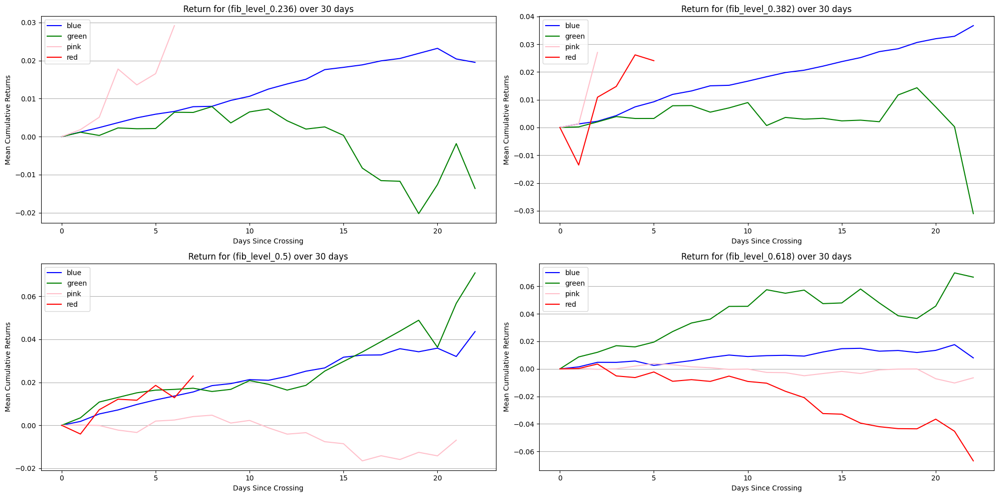

In [11]:
import matplotlib.pyplot as plt

regimes = ['blue', 'green', 'pink', 'red']
fib_levels = ['fib_level_0.236', 'fib_level_0.382', 'fib_level_0.5','fib_level_0.618']
rows = len(fib_levels)//2+len(fib_levels)%2
mean_returns = {level: {} for level in fib_levels}

for level in fib_levels:
    data[f'cross_{level}'] = (data['Close'] < data[level]) & (data['Close'].shift(1) > data[level].shift(1))  # Change here
    crossings = data[data[f'cross_{level}']]

    for regime in regimes:
        returns = []

        for date in crossings.index:
            next_30_days = data.loc[date:date + pd.Timedelta(days=30)]
            
            next_30_days['returns'] = next_30_days['Close'].pct_change() + 1
            next_30_days['returns'].iloc[0] = 1
            next_30_days['cumulative_returns'] = next_30_days['returns'].cumprod() - 1

            current_regime = next_30_days['regime'].iloc[0]
            
            if current_regime == regime:
                daily_returns = []
                for next_date, row in next_30_days.iterrows():
                    if row['regime'] != regime:
                        break
                    daily_returns.append(row['cumulative_returns'])
                returns.append(daily_returns)

        if returns:
            max_length = max(len(r) for r in returns)
            returns_padded = [r + [np.nan]*(max_length - len(r)) for r in returns]
        else:
            returns_padded = []

        returns_array = np.array(returns_padded)
        mean_returns[level][regime] = np.nanmean(returns_array, axis=0)

fig, axs = plt.subplots(rows, 2, figsize=(20, 10))

# Flatten the axes array for easy iteration
axs = axs.flatten()

for ax, level in zip(axs, fib_levels):
    for regime, returns in mean_returns[level].items():
        if isinstance(returns, np.ndarray):
            ax.plot(range(len(returns)), returns, color=regime, label=regime)
        else:
            ax.plot(0, returns, color=regime, label=regime)
    ax.set_title(f'Return for ({level}) over 30 days')
    ax.set_xlabel('Days Since Crossing')
    ax.set_ylabel('Mean Cumulative Returns')
    ax.legend()
    ax.grid(axis='y')

plt.tight_layout()
plt.show()

Fib 0.236 - LONG Bearish and Bullish low var  
Fib 0.382 - LONG Bullish low var  
Fib 0.5 - LONG Bullish high var and low var and LONG bearish high var  
Fib 0.618 - LONG Bullish high var and SHORT Bearish high var  

LONG Bearish low var - Fib 0.236  
LONG Bearish high var -  Fib 0.5, Fib 0.382  
LONG Bullish low var -  Fib 0.382, Fib 0.5, 0.236  
LONG Bullish high var -  Fib 0.5, Fib 0.618  
SHORT Bearish low var - Fib 0.5   
SHORT Bearish high var - Fib 0.618  
SHORT Bullish low var -   
SHORT Bullish high var -  


## Price trends for MACD Indicator

/var/folders/_b/pxw2mfds5xdfm3fbn8tyr7mr0000gn/T/ipykernel_39503/1435909846.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  next_30_days['returns'] = next_30_days['Close'].pct_change() + 1
/var/folders/_b/pxw2mfds5xdfm3fbn8tyr7mr0000gn/T/ipykernel_39503/1435909846.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  next_30_days['returns'].iloc[0] = 1
/var/folders/_b/pxw2mfds5xdfm3fbn8tyr7mr0000gn/T/ipykernel_39503/1435909846.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_inde

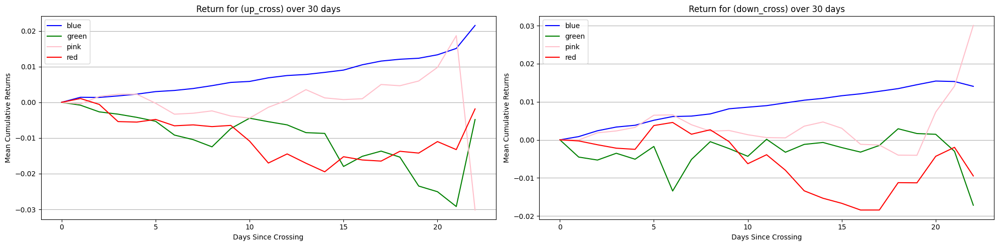

In [12]:
import matplotlib.pyplot as plt

regimes = ['blue', 'green', 'pink', 'red']
macd_crosses = ['up_cross', 'down_cross']
mean_returns = {cross: {} for cross in macd_crosses}
rows = len(macd_crosses)//2+len(macd_crosses)%2

# Define up and down crossovers
data['up_cross'] = (data['MACD_histogram'] > 0) & (data['MACD_histogram'].shift(1) < 0)
data['down_cross'] = (data['MACD_histogram'] < 0) & (data['MACD_histogram'].shift(1) > 0)

for cross in macd_crosses:
    crossings = data[data[cross]]

    for regime in regimes:
        returns = []

        for date in crossings.index:
            next_30_days = data.loc[date:date + pd.Timedelta(days=30)]
            
            next_30_days['returns'] = next_30_days['Close'].pct_change() + 1
            next_30_days['returns'].iloc[0] = 1
            next_30_days['cumulative_returns'] = next_30_days['returns'].cumprod() - 1

            current_regime = next_30_days['regime'].iloc[0]
            
            if current_regime == regime:
                daily_returns = []
                for next_date, row in next_30_days.iterrows():
                    if row['regime'] != regime:
                        break
                    daily_returns.append(row['cumulative_returns'])
                returns.append(daily_returns)

        if returns:
            max_length = max(len(r) for r in returns)
            returns_padded = [r + [np.nan]*(max_length - len(r)) for r in returns]
        else:
            returns_padded = []

        returns_array = np.array(returns_padded)
        mean_returns[cross][regime] = np.nanmean(returns_array, axis=0)

fig, axs = plt.subplots(rows, 2, figsize=(20, 5))

# Flatten the axes array for easy iteration
axs = axs.flatten()

for ax, cross in zip(axs, macd_crosses):
    for regime, returns in mean_returns[cross].items():
        if isinstance(returns, np.ndarray):
            ax.plot(range(len(returns)), returns, color=regime, label=regime)
        else:
            ax.plot(0, returns, color=regime, label=regime)
    ax.set_title(f'Return for ({cross}) over 30 days')
    ax.set_xlabel('Days Since Crossing')
    ax.set_ylabel('Mean Cumulative Returns')
    ax.legend()
    ax.grid(axis='y')

plt.tight_layout()
plt.show()

MACD Up crossover - LONG Bullish low var
MACD Down crossover - LONG Bullish low var, SHORT 

Up cross - SHORT Bullish and bearish high var

## Price trends for RSI

/var/folders/_b/pxw2mfds5xdfm3fbn8tyr7mr0000gn/T/ipykernel_39503/1400257162.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  next_30_days['returns'] = next_30_days['Close'].pct_change() + 1
/var/folders/_b/pxw2mfds5xdfm3fbn8tyr7mr0000gn/T/ipykernel_39503/1400257162.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  next_30_days['returns'].iloc[0] = 1
/var/folders/_b/pxw2mfds5xdfm3fbn8tyr7mr0000gn/T/ipykernel_39503/1400257162.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_inde

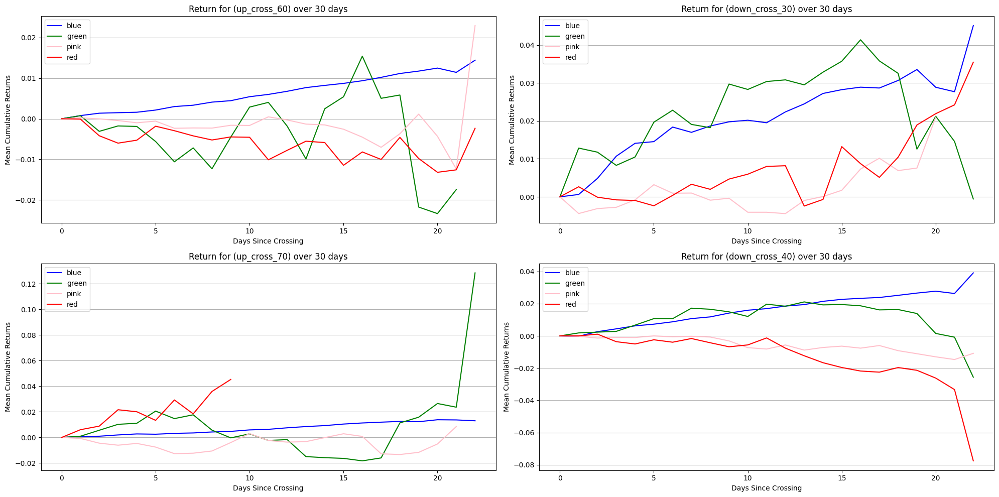

In [13]:
import matplotlib.pyplot as plt

regimes = ['blue', 'green', 'pink', 'red']
rsi_crosses = ['up_cross_60', 'down_cross_30', 'up_cross_70', 'down_cross_40']
rows = len(rsi_crosses)//2+len(rsi_crosses)%2
mean_returns = {cross: {} for cross in rsi_crosses}

# Define up and down crossovers
data['up_cross_60'] = (data['RSI'] > 60) & (data['RSI'].shift(1) < 60)
data['down_cross_30'] = (data['RSI'] < 30) & (data['RSI'].shift(1) > 30)
data['up_cross_70'] = (data['RSI'] > 70) & (data['RSI'].shift(1) < 70)
data['down_cross_40'] = (data['RSI'] < 40) & (data['RSI'].shift(1) > 40)

for cross in rsi_crosses:
    crossings = data[data[cross]]

    for regime in regimes:
        returns = []

        for date in crossings.index:
            next_30_days = data.loc[date:date + pd.Timedelta(days=30)]
            
            next_30_days['returns'] = next_30_days['Close'].pct_change() + 1
            next_30_days['returns'].iloc[0] = 1
            next_30_days['cumulative_returns'] = next_30_days['returns'].cumprod() - 1

            current_regime = next_30_days['regime'].iloc[0]
            
            if current_regime == regime:
                daily_returns = []
                for next_date, row in next_30_days.iterrows():
                    if row['regime'] != regime:
                        break
                    daily_returns.append(row['cumulative_returns'])
                returns.append(daily_returns)

        if returns:
            max_length = max(len(r) for r in returns)
            returns_padded = [r + [np.nan]*(max_length - len(r)) for r in returns]
        else:
            returns_padded = []

        returns_array = np.array(returns_padded)
        mean_returns[cross][regime] = np.nanmean(returns_array, axis=0)

fig, axs = plt.subplots(rows, 2, figsize=(20, 10))

# Flatten the axes array for easy iteration
axs = axs.flatten()

for ax, cross in zip(axs, rsi_crosses):
    for regime, returns in mean_returns[cross].items():
        if isinstance(returns, np.ndarray):
            ax.plot(range(len(returns)), returns, color=regime, label=regime)
        else:
            ax.plot(0, returns, color=regime, label=regime)
    ax.set_title(f'Return for ({cross}) over 30 days')
    ax.set_xlabel('Days Since Crossing')
    ax.set_ylabel('Mean Cumulative Returns')
    ax.legend()
    ax.grid(axis='y')

plt.tight_layout()
plt.show()

RSI Up 60 - LONG bullish low var SHORT bearish high var  
RSI Down 30 - LONG Bullish high and low var LONG bearish low var
RSI Down 40 - SHORT Bearish high var  

SHORT Bearish low var -  
SHORT Bearish high var - RSI 40, 60  
SHORT Bullish low var -  
SHORT Bullish high var - RSI 60 
LONG Bearish low var - RSI 30?  
LONG Bearish high var - RSI 30, 70  
LONG Bullihs low var - All, especially RSI 30 and 40  
LONG Bullish high var - RSI 30  

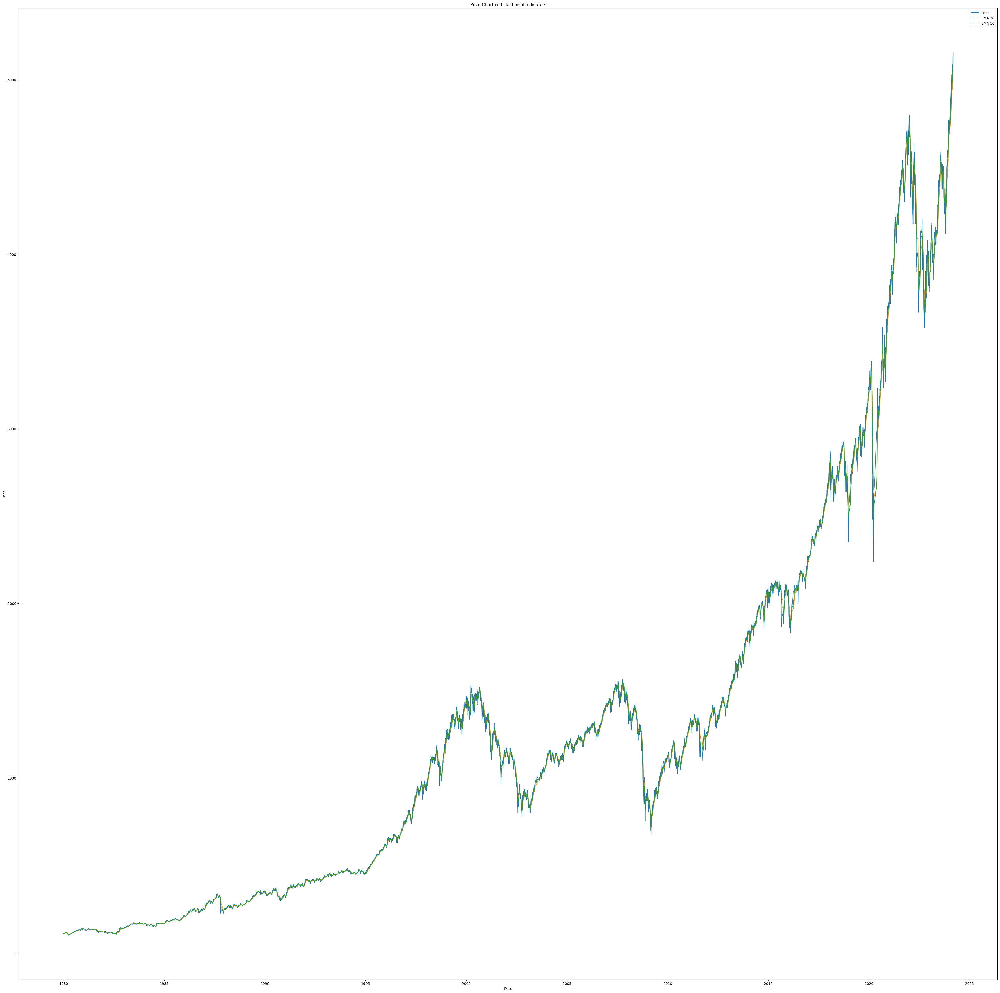

In [14]:
import matplotlib.pyplot as plt

# Set the figsize
fig, ax = plt.subplots(figsize=(50, 50))

# Plot the price chart
ax.plot(data.index, data['Close'], label='Price')

# Plot the technical indicators
ax.plot(data.index, data['ema_20'], label='EMA 20')
ax.plot(data.index, data['ema_10'], label='EMA 10')
# ax.plot(data.index, data['upper_band_1sd'], label='Upper Band 1SD')
# ax.plot(data.index, data['lower_band_1sd'], label='Lower Band 1SD')
# ax.plot(data.index, data['upper_band_1.5sd'], label='Upper Band 1.5SD')
# ax.plot(data.index, data['lower_band_1.5sd'], label='Lower Band 1.5SD')
# ax.plot(data.index, data['upper_band_2sd'], label='Upper Band 2SD')
# ax.plot(data.index, data['lower_band_2sd'], label='Lower Band 2SD')
# ax.plot(data.index, data['fib_level_0.236'], label='Fib Level 0.236')
# ax.plot(data.index, data['fib_level_0.382'], label='Fib Level 0.382')
# ax.plot(data.index, data['fib_level_0.5'], label='Fib Level 0.5')
# ax.plot(data.index, data['fib_level_0.618'], label='Fib Level 0.618')

# Set the plot title and labels
ax.set_title('Price Chart with Technical Indicators')
ax.set_xlabel('Date')
ax.set_ylabel('Price')

# Add a legend
ax.legend()

# Display the plot
plt.show()
